In [65]:
# general
import os
BASE_DIR = os.path.dirname(os.path.dirname(os.path.abspath('__file__')))

from pathlib import Path

import warnings

from IPython.core.display import display, HTML

# computation
import math
import numpy as np
import pandas as pd
import geoglows
import hydrostats.data as hd
import hydrostats.analyze as ha
from scipy import interpolate

# plotting
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# import plotly.offline as pyo
# pyo.init_notebook_mode()

In [35]:
stations = ['Neak_Luong', 'Stung_Treng', 'Chaktomuk', 'Kompong_Kdei', 'Prek_Kdam', 'Kg._Thmar',
            'Koh_Khel', 'Lumphat', 'Kompong_Cham', 'Phnom_Penh_Port', 'Voeun_Sai', 'Kratie', 
            'Kompong_Chen', 'Kompong_Cham', 'Sisophon'
           ]
# 'Kompong_Thom', 'Battambang', 'Siempang'

In [36]:
Path(f'{BASE_DIR}/spt_vs_mrc/').mkdir(parents=True, exist_ok=True)

dfs_obs = []
dfs_pred = []
dfs = []

for station in stations:
    obs = pd.read_csv(f'{BASE_DIR}/mrc_observations/{station}.csv')
    obs['datetime'] = pd.to_datetime(obs['datetime'])
    obs = obs.set_index('datetime')
#     dfs_obs.append({'station': station, 'df': obs})

    pred = pd.read_csv(f'{BASE_DIR}/spt_predictions/{station}.csv')
    pred['datetime'] = pd.to_datetime(pred['datetime'])
    pred = pred.set_index('datetime')
#     dfs_pred.append({'station': station, 'df': pred})

    obs = obs.rename(columns={'discharge': 'observation'})
    pred = pred.rename(columns={'discharge': 'prediction'})
    df = pd.merge(obs, pred, how='inner', on='datetime')
#     df.sort_values(by=['datetime'], ascending=True, inplace=True)
    dfs.append({'station': station, 'df_obs': obs, 'df_pred': pred})
    

In [37]:
def correct_historical(simulated_data: pd.DataFrame, observed_data: pd.DataFrame) -> pd.DataFrame:
    """
    Copied from GeoGlows Github repo
    Accepts a historically simulated flow timeseries and observed flow timeseries and attempts to correct biases in the
    simulation on a monthly basis.
    Args:
        simulated_data: A dataframe with a datetime index and a single column of streamflow values
        observed_data: A dataframe with a datetime index and a single column of streamflow values
    Returns:
        pandas DataFrame with a datetime index and a single column of streamflow values
    """
    # list of the unique months in the historical simulation. should always be 1->12 but just in case...
    unique_simulation_months = sorted(set(simulated_data.index.strftime('%m')))
    dates = []
    values = []

    for month in unique_simulation_months:
        # filter historic data to only be current month
        monthly_simulated = simulated_data[simulated_data.index.month == int(month)].dropna()
        to_prob = _flow_and_probability_mapper(monthly_simulated, to_probability=True)
        # filter the observations to current month
        monthly_observed = observed_data[observed_data.index.month == int(month)].dropna()
        to_flow = _flow_and_probability_mapper(monthly_observed, to_flow=True)

        dates += monthly_simulated.index.to_list()
        value = to_flow(to_prob(monthly_simulated.values))
        values += value.tolist()

    corrected = pd.DataFrame(data=values, index=dates, columns=['Corrected Simulated Streamflow'])
    corrected.sort_index(inplace=True)
    return corrected

In [42]:
def _flow_and_probability_mapper(monthly_data: pd.DataFrame, to_probability: bool = False,
                                 to_flow: bool = False, extrapolate: bool = False) -> interpolate.interp1d:
    """     Copied from GeoGlows Github repo
    """
    if not to_flow and not to_probability:
        raise ValueError('You need to specify either to_probability or to_flow as True')

    # get maximum value to bound histogram
    max_val = math.ceil(np.max(monthly_data.max()))
    min_val = math.floor(np.min(monthly_data.min()))
    if max_val == min_val:
        warnings.warn('The observational data has the same max and min value. You may get unanticipated results.')
        max_val += .1

    # determine number of histograms bins needed
    number_of_points = len(monthly_data.values)
    number_of_classes = math.ceil(1 + (3.322 * math.log10(number_of_points)))

    # specify the bin width for histogram (in m3/s)
    step_width = (max_val - min_val) / number_of_classes

    # specify histogram bins
    bins = np.arange(-np.min(step_width), max_val + 2 * np.min(step_width), np.min(step_width))
    if bins[0] == 0:
        bins = np.concatenate((-bins[1], bins))
    elif bins[0] > 0:
        bins = np.concatenate((-bins[0], bins))

    # make the histogram
    counts, bin_edges = np.histogram(monthly_data, bins=bins)

    # adjust the bins to be the center
    bin_edges = bin_edges[1:]

    # normalize the histograms
    counts = counts.astype(float) / monthly_data.size

    # calculate the cdfs
    cdf = np.cumsum(counts)

    # interpolated function to convert simulated streamflow to prob
    if to_probability:
        if extrapolate:
            return interpolate.interp1d(bin_edges, cdf, fill_value='extrapolate')
        return interpolate.interp1d(bin_edges, cdf)
    # interpolated function to convert simulated prob to observed streamflow
    elif to_flow:
        if extrapolate:
            return interpolate.interp1d(cdf, bin_edges, fill_value='extrapolate')
        return interpolate.interp1d(cdf, bin_edges)

<ipython-input-42-dfb3bbd62053>:12: UserWarning:

The observational data has the same max and min value. You may get unanticipated results.

<ipython-input-42-dfb3bbd62053>:12: UserWarning:

The observational data has the same max and min value. You may get unanticipated results.

<ipython-input-42-dfb3bbd62053>:12: UserWarning:

The observational data has the same max and min value. You may get unanticipated results.



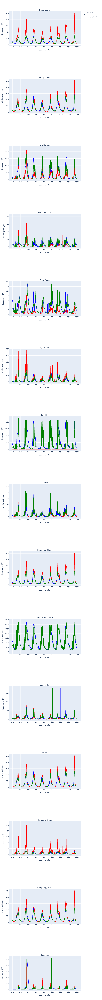

In [88]:
fig = make_subplots(rows=len(dfs), cols=1, start_cell='top-left', subplot_titles = [station['station'] for station in dfs])

for idx, station in enumerate(dfs):

    name = station['station']
    
    df_pred = station['df_pred']
    df_obs = station['df_obs']
#     bias_corrected = geoglows.bias.correct_historical(df_pred, df_obs)
    bias_corrected = correct_historical(df_pred, df_obs)
    
    station['df_bcorr'] = bias_corrected

#   # webgl for fast render
    fig.add_trace(go.Scattergl(x=df_pred.index,
                               y=df_pred.prediction,
#                                name=f'{name} observed',
                               name=f'Prediction',
                               mode='lines',
                               line=dict(color='red'),
                               showlegend=True if idx == 0 else False,
                              ),
                  row=idx+1, col=1)

    fig.add_trace(go.Scattergl(x=df_obs.index,
                               y=df_obs.observation,
                               mode='lines+text',
#                                name = f'{dfs_pred[idx]["station"]} predicted',
                               name = f'Observation',
                               line=dict(color='blue'),
                               showlegend=True if idx == 0 else False,
                              ),
                  row=idx+1, col=1)
    
    fig.add_trace(go.Scattergl(x=bias_corrected.index,
                               y=bias_corrected['Corrected Simulated Streamflow'],
                               mode='lines+text',
#                                name = f'{dfs_pred[idx]["station"]} predicted',
                               name = f'Corrected Prediction',
                               line=dict(color='green'),
                               showlegend=True if idx == 0 else False,
                              ),
                  row=idx+1, col=1)

    fig.update_xaxes(title_text='datetime (utc)', row=idx+1, col=1)
    fig.update_yaxes(title_text='discharge (m3/s)', row=idx+1, col=1)

fig.update_layout(height=len(dfs)*600, width=1000)
fig.show()


------------------------------
Station: Neak_Luong


,Corrected Full Time Series,Original Full Time Series
ME,38.171263,4750.133204
RMSE,2006.331324,11804.669469
NRMSE (Mean),0.200630,1.180446
MAPE,15.668994,56.034852
NSE,0.913075,-2.009171
KGE (2009),0.956399,-0.539992
KGE (2012),0.956546,0.175274
R (Pearson),0.956715,0.922449
R (Spearman),0.935664,0.899106
r2,0.915303,0.850913


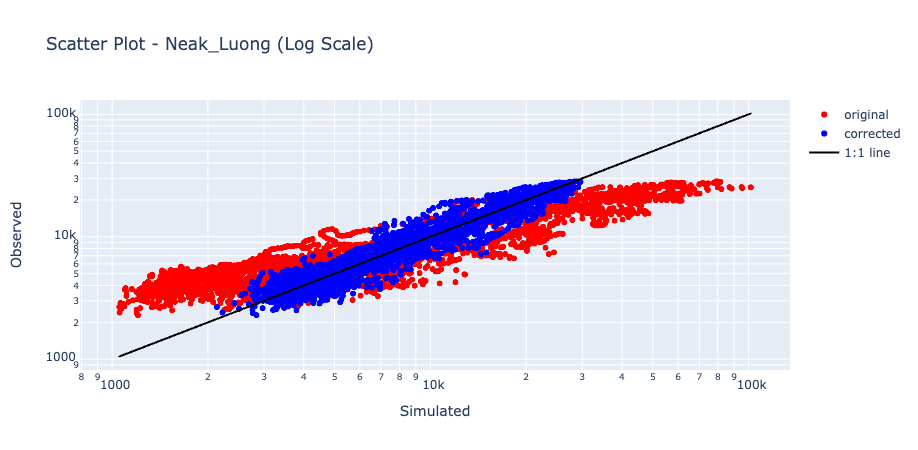

------------------------------
Station: Stung_Treng


,Corrected Full Time Series,Original Full Time Series
ME,-30.022743,1800.386004
RMSE,3020.578775,6534.609005
NRMSE (Mean),0.257007,0.555999
MAPE,16.757811,35.832364
NSE,0.923524,0.642079
KGE (2009),0.961574,0.553057
KGE (2012),0.961606,0.719702
R (Pearson),0.961700,0.944373
R (Spearman),0.929370,0.927681
r2,0.924866,0.891841


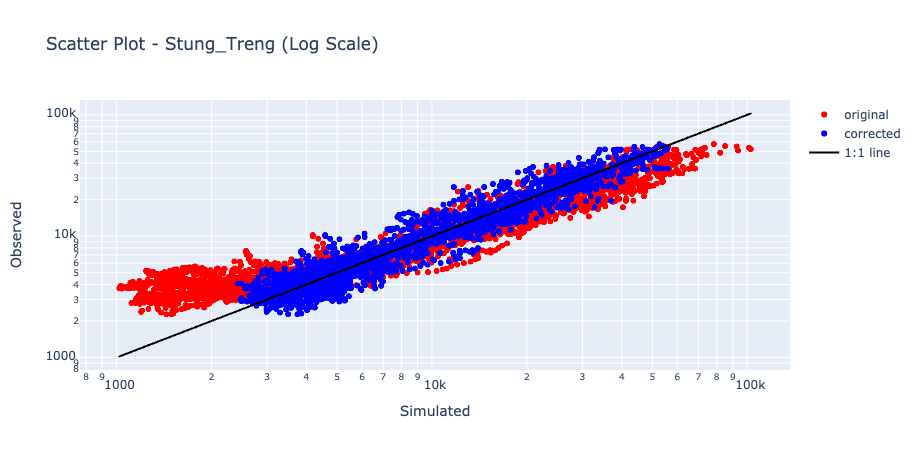

------------------------------
Station: Chaktomuk


,Corrected Full Time Series,Original Full Time Series
ME,-0.596375,-421.031083
RMSE,808.732997,1148.194524
NRMSE (Mean),0.704107,0.999652
MAPE,47.369935,84.330659
NSE,0.741751,0.479453
KGE (2009),0.870924,0.428512
KGE (2012),0.870921,0.555710
R (Pearson),0.870925,0.749190
R (Spearman),0.927699,0.846145
r2,0.758511,0.561286


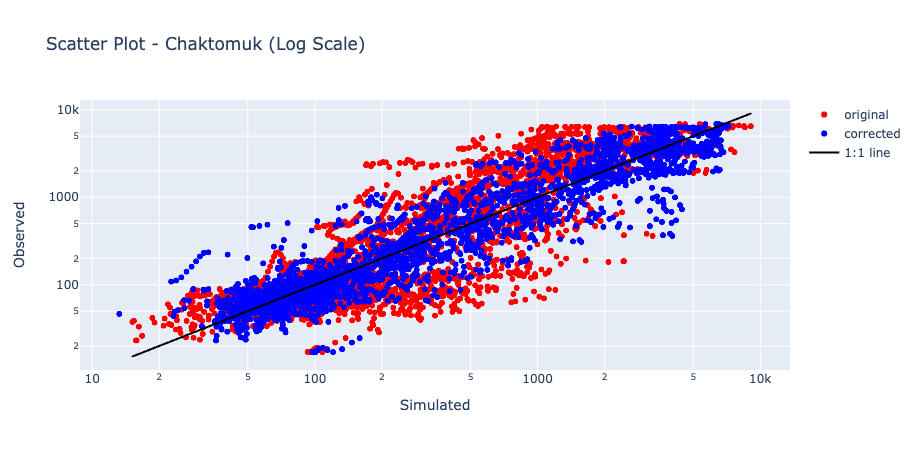

------------------------------
Station: Kompong_Kdei


/Users/biplovbhandari/miniconda3/envs/cbias/lib/python3.9/site-packages/HydroErr/HydroErr.py:1859: RuntimeWarning:

divide by zero encountered in true_divide



,Corrected Full Time Series,Original Full Time Series
ME,-0.741811,-4.276999
RMSE,5.355500,7.161875
NRMSE (Mean),0.805131,1.076696
MAPE,inf,inf
NSE,0.266965,-0.310926
KGE (2009),0.631206,0.141563
KGE (2012),0.601540,-0.401633
R (Pearson),0.649309,0.483616
R (Spearman),0.663943,0.598329
r2,0.421603,0.233885


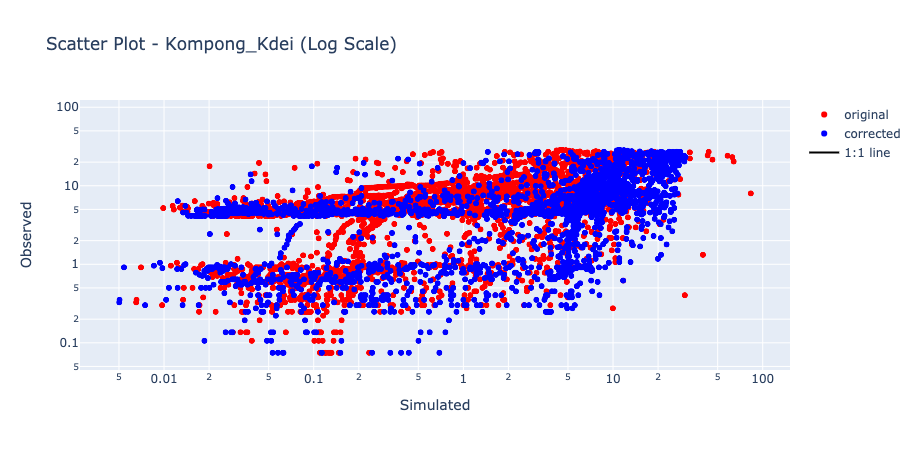

------------------------------
Station: Prek_Kdam


,Corrected Full Time Series,Original Full Time Series
ME,25.049783,-2121.226528
RMSE,1311.739688,2940.663481
NRMSE (Mean),0.461800,1.035265
MAPE,40.543194,78.140246
NSE,0.648293,-0.767567
KGE (2009),0.820631,-0.104438
KGE (2012),0.819675,-0.251175
R (Pearson),0.821535,0.394848
R (Spearman),0.814909,0.599214
r2,0.674920,0.155905


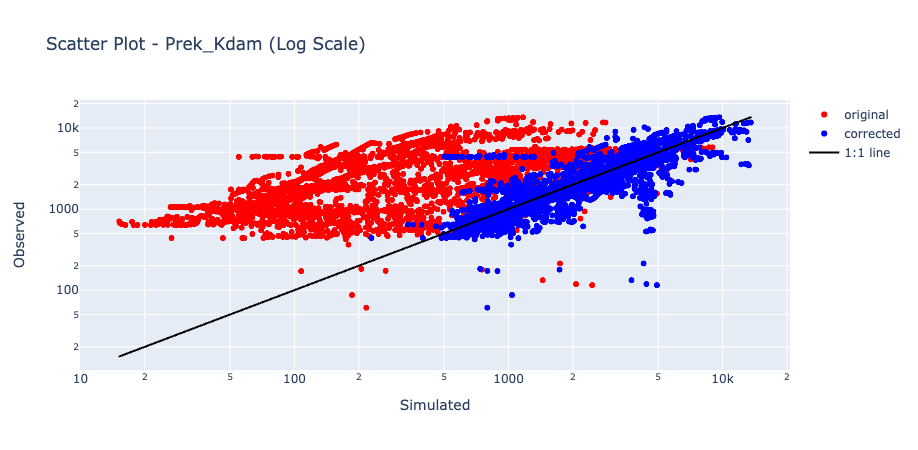

------------------------------
Station: Kg._Thmar


,Corrected Full Time Series,Original Full Time Series
ME,-1.398322,24.344261
RMSE,37.470711,79.167597
NRMSE (Mean),0.821514,1.735684
MAPE,81.376771,146.182828
NSE,0.662598,-0.506116
KGE (2009),0.828927,0.054567
KGE (2012),0.825845,0.402075
R (Pearson),0.831699,0.768407
R (Spearman),0.854578,0.842562
r2,0.691724,0.590449


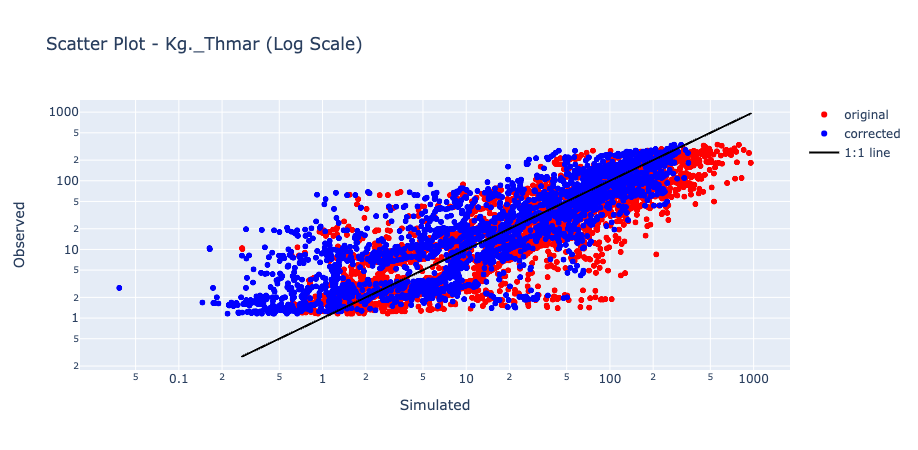

------------------------------
Station: Koh_Khel


,Corrected Full Time Series,Original Full Time Series
ME,-421.106599,-1091.282288
RMSE,969.262137,1622.027776
NRMSE (Mean),0.887693,1.485525
MAPE,50.886289,99.932237
NSE,0.348353,-0.824933
KGE (2009),0.473307,-0.579141
KGE (2012),0.414876,-1.715465
R (Pearson),0.695922,0.293888
R (Spearman),0.786466,0.436600
r2,0.484307,0.086370


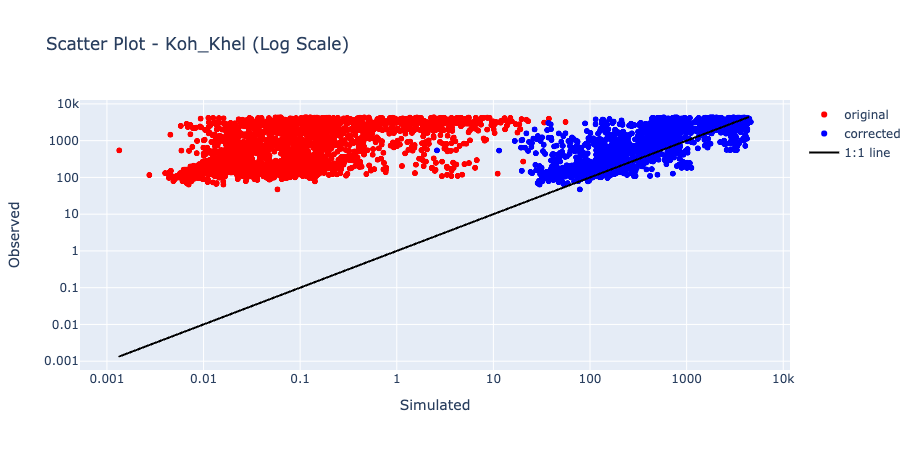

------------------------------
Station: Lumphat


,Corrected Full Time Series,Original Full Time Series
ME,2.108191,-239.401453
RMSE,586.521186,644.722038
NRMSE (Mean),0.759884,0.835287
MAPE,38.399900,52.105249
NSE,0.629293,0.552072
KGE (2009),0.814526,0.573717
KGE (2012),0.814498,0.587719
R (Pearson),0.814547,0.783717
R (Spearman),0.871324,0.896728
r2,0.663487,0.614212


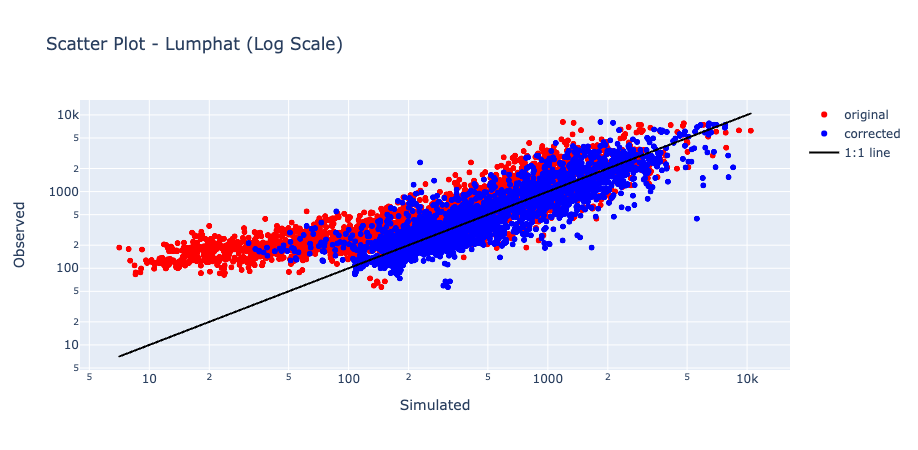

------------------------------
Station: Kompong_Cham


,Corrected Full Time Series,Original Full Time Series
ME,-58.440280,2215.845873
RMSE,2795.886816,7122.239536
NRMSE (Mean),0.237103,0.603995
MAPE,17.164216,33.773922
NSE,0.931176,0.553381
KGE (2009),0.964806,0.463410
KGE (2012),0.965100,0.672971
R (Pearson),0.965456,0.948872
R (Spearman),0.940700,0.940276
r2,0.932105,0.900357


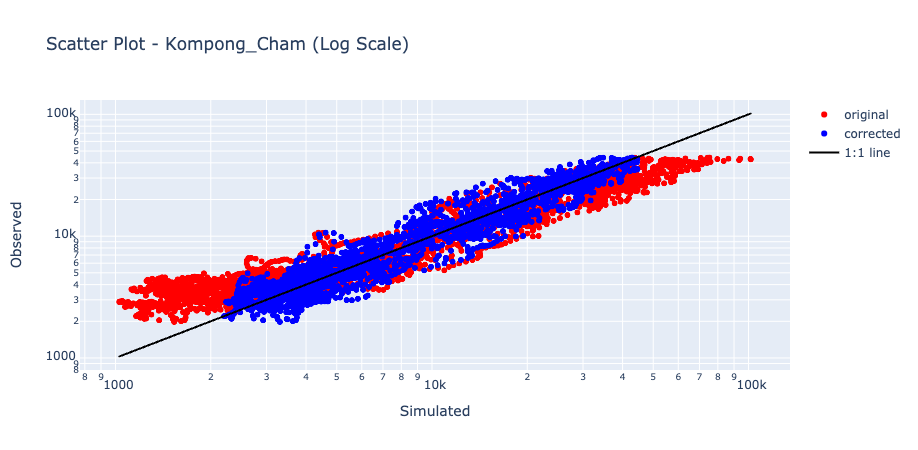

------------------------------
Station: Phnom_Penh_Port


,Corrected Full Time Series,Original Full Time Series
ME,-310.252906,-2289.471394
RMSE,963.973128,2843.815344
NRMSE (Mean),0.420916,1.241742
MAPE,31.339763,99.976726
NSE,0.673752,-1.839359
KGE (2009),0.798124,-0.514351
KGE (2012),0.756872,-1.585516
R (Pearson),0.851341,0.455997
R (Spearman),0.860641,0.722988
r2,0.724782,0.207934


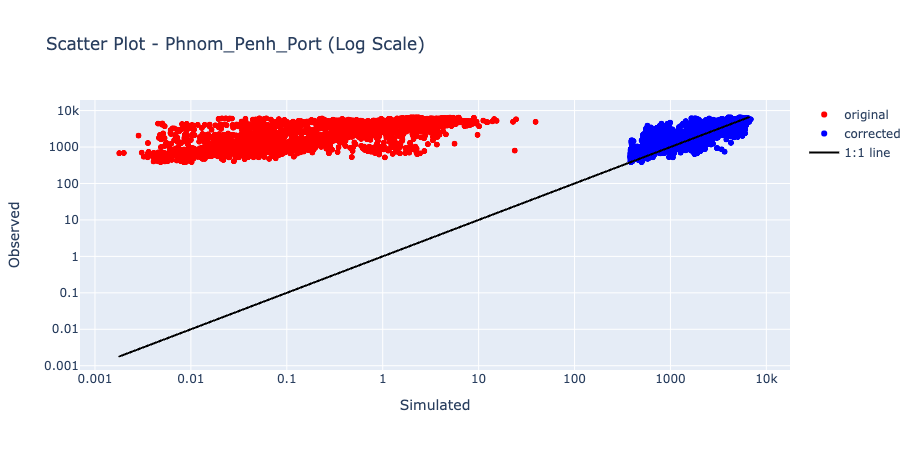

------------------------------
Station: Voeun_Sai


,Corrected Full Time Series,Original Full Time Series
ME,1.396489,-298.537540
RMSE,657.946265,694.393409
NRMSE (Mean),0.781154,0.824427
MAPE,33.898792,64.563181
NSE,0.291887,0.211261
KGE (2009),0.648229,0.529761
KGE (2012),0.648256,0.218088
R (Pearson),0.648295,0.695071
R (Spearman),0.810834,0.828502
r2,0.420287,0.483123


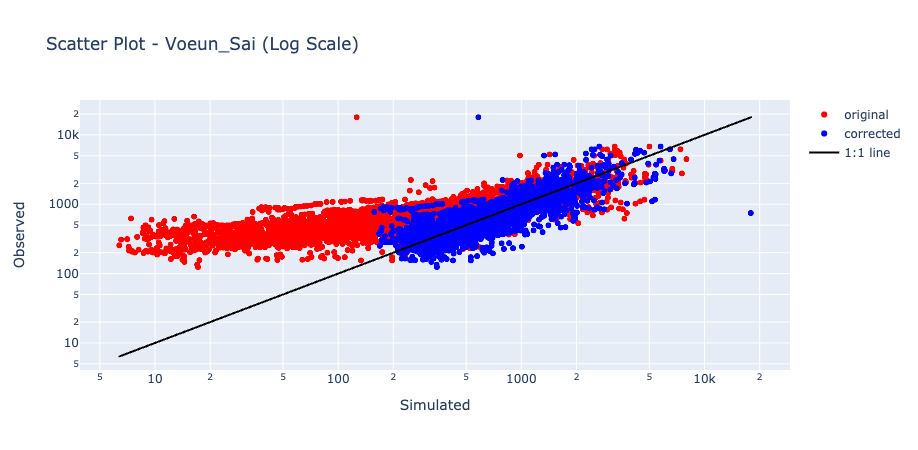

------------------------------
Station: Kratie


,Corrected Full Time Series,Original Full Time Series
ME,-59.963679,2031.312158
RMSE,2971.482361,6664.383223
NRMSE (Mean),0.253125,0.567703
MAPE,16.055348,35.383492
NSE,0.928649,0.641102
KGE (2009),0.963092,0.548673
KGE (2012),0.963705,0.726382
R (Pearson),0.964114,0.945232
R (Spearman),0.936755,0.932505
r2,0.929516,0.893463


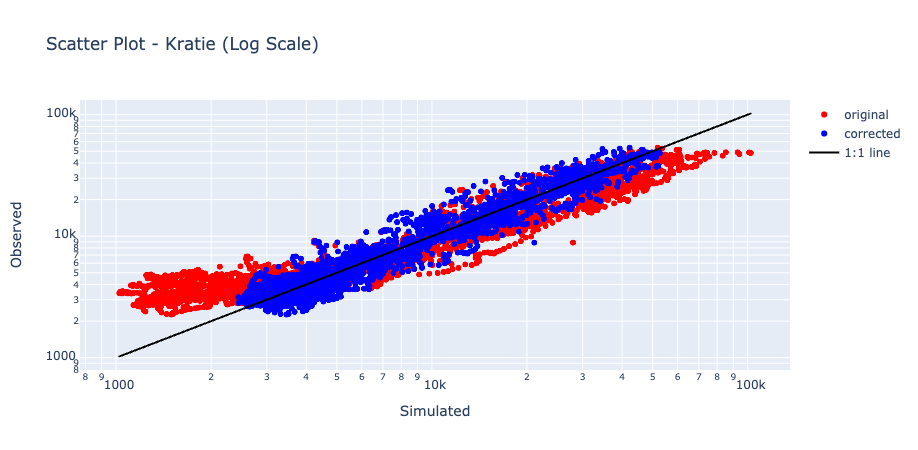

------------------------------
Station: Kompong_Chen


/Users/biplovbhandari/miniconda3/envs/cbias/lib/python3.9/site-packages/HydroErr/HydroErr.py:1859: RuntimeWarning:

divide by zero encountered in true_divide



,Corrected Full Time Series,Original Full Time Series
ME,-0.055534,17.679323
RMSE,10.294362,43.141738
NRMSE (Mean),0.828869,3.473635
MAPE,inf,inf
NSE,0.604383,-5.948186
KGE (2009),0.798372,-1.446281
KGE (2012),0.798679,-0.477100
R (Pearson),0.799073,0.674379
R (Spearman),0.826456,0.783387
r2,0.638518,0.454787


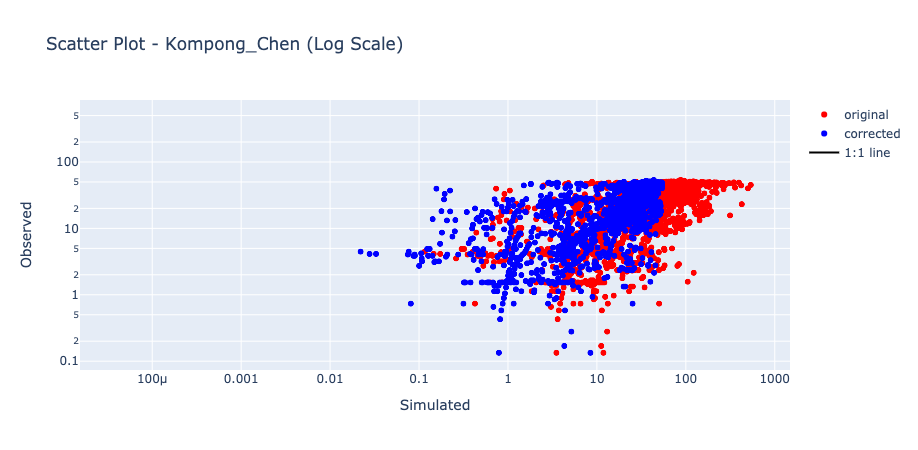

------------------------------
Station: Kompong_Cham


,Corrected Full Time Series,Original Full Time Series
ME,-58.440280,2215.845873
RMSE,2795.886816,7122.239536
NRMSE (Mean),0.237103,0.603995
MAPE,17.164216,33.773922
NSE,0.931176,0.553381
KGE (2009),0.964806,0.463410
KGE (2012),0.965100,0.672971
R (Pearson),0.965456,0.948872
R (Spearman),0.940700,0.940276
r2,0.932105,0.900357


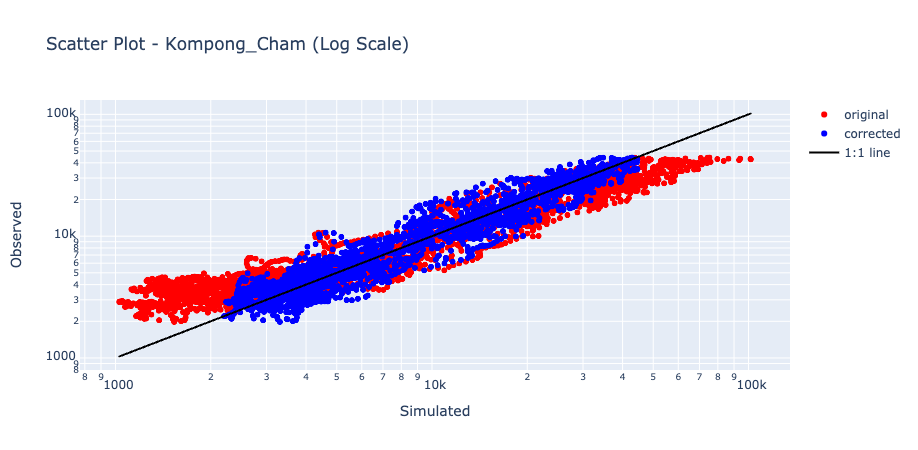

------------------------------
Station: Sisophon


,Corrected Full Time Series,Original Full Time Series
ME,-2.467731,-2.178527
RMSE,68.014904,68.787390
NRMSE (Mean),3.154237,3.190061
MAPE,2718.795510,3647.210931
NSE,-0.670630,-0.708794
KGE (2009),0.221633,0.190657
KGE (2012),0.194072,0.172612
R (Pearson),0.234854,0.199522
R (Spearman),0.605425,0.511888
r2,0.055156,0.039809


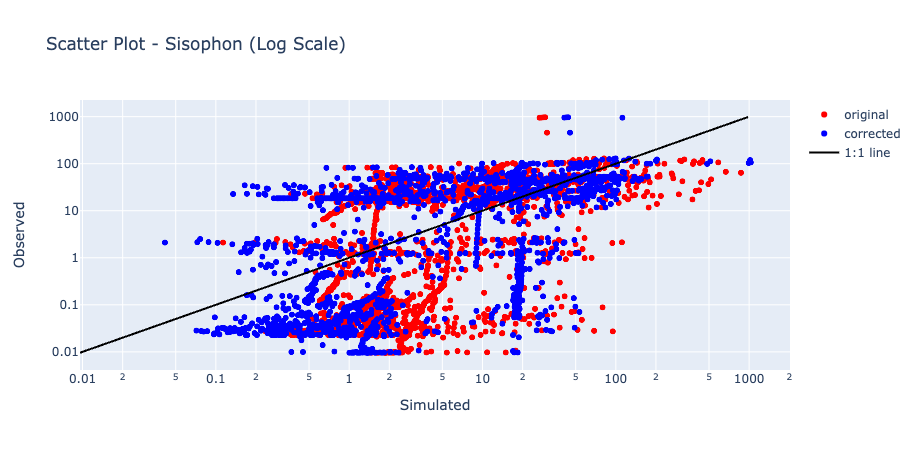

In [89]:
# ['Mean Error', 'Root Mean Square Error', 'Normalized Root Mean Square Error - Mean', 'Mean Absolute Percentage Error',
# 'Nash-Sutcliffe Efficiency', 'Kling-Gupta Efficiency (2009)', 'Kling-Gupta Efficiency (2012)', 'Pearson Correlation Coefficient',
# 'Spearman Rank Correlation Coefficient', 'Spearman Rank Correlation Coefficient', 'Coefficient of Determination'
# ]

# NSE - baseline is the mean of the observationn
# if the NSE <= 0, the model is no better than using the observed mean as the predictor

# 

metrics = ['ME', 'RMSE', 'NRMSE (Mean)', 'MAPE', 'NSE', 'KGE (2009)', 'KGE (2012)', 'R (Pearson)', 'R (Spearman)', 'r2']

for idx, station in enumerate(dfs):

    print('------------------------------')
    name = station['station']
    print(f'Station: {name}')
    
    df_pred = station['df_pred']
    df_obs = station['df_obs']
    df_bcorr = station['df_bcorr']

    df_orig = hd.merge_data(sim_df=df_pred, obs_df=df_obs)
    df_bcorr = hd.merge_data(sim_df=df_bcorr, obs_df=df_obs)

    # # Merge Data
    metrics_orig_vs_pred = ha.make_table(merged_dataframe=df_orig, metrics=metrics)
    metrics_orig_vs_bcorr = ha.make_table(merged_dataframe=df_bcorr, metrics=metrics)

    metrics_orig_vs_bcorr = metrics_orig_vs_bcorr.rename(index={'Full Time Series': 'Corrected Full Time Series'})
    metrics_orig_vs_pred = metrics_orig_vs_pred.rename(index={'Full Time Series': 'Original Full Time Series'})

    # df_orig_vs_bcorr
    metrics_orig_vs_bcorr = metrics_orig_vs_bcorr.transpose()
    metrics_orig_vs_pred = metrics_orig_vs_pred.transpose()

    table_final = pd.merge(metrics_orig_vs_bcorr, metrics_orig_vs_pred, right_index=True, left_index=True)

    display(HTML(table_final.to_html()))
    
    scatter = go.Scattergl(x=df_orig.Simulated.values,
                           y=df_orig.Observed.values,
                           mode='markers',
                           name='original',
                           marker=dict(color='red')
                          )
    
    scatter2 = go.Scattergl(x=df_bcorr.Simulated.values,
                            y=df_bcorr.Observed.values,
                            mode='markers',
                            name='corrected',
                            marker=dict(color='blue')
                           )
    
    min_orig = min(min(df_orig.Simulated.values), min(df_orig.Observed.values))
    max_orig = max(max(df_orig.Simulated.values), max(df_orig.Observed.values))
    
#     min_bcorr = min(min(df_bcorr.Simulated.values), min(df_bcorr.Observed.values))
#     max_bcorr = max(max(df_bcorr.Simulated.values), max(df_bcorr.Observed.values))
    
    desired = go.Scattergl(x=[min_orig, max_orig],
                           y=[min_orig, max_orig],
                           mode='lines',
                           name='1:1 line',
                           line=dict(color='black')
                          )
    layout = go.Layout(title=f'Scatter Plot - {name} (Log Scale)',
                       xaxis=dict(title='Simulated', type='log'),
                       yaxis=dict(title='Observed', type='log'),
                       showlegend=True)

    chart_obj = go.Figure(data=[scatter, scatter2, desired], layout=layout)

    chart_obj.show()
    